<center> <span style="font-family:newtimeroman"> <span style="padding:350px;display:fill;border-radius:250px 250px;background-color:#D72A2B;font-size:200%;font-weight: 600;color:#F2ECC6;overflow:hidden;"> 5.6. DBSCANㅤ</span>

<div style="border-radius:15px;border:#B71C1B solid;background-color:#F2ECC6; padding:20px; font-size:15px">

### ✍️DBSCAN

**DBSCAN** (Density-Based Spatial Clustering of Applications with Noise) is a clustering algorithm that is used to group together data points that are close to each other in a high-density region while also identifying the noise or sparse regions in the data. It works by defining clusters as areas of high density separated by areas of low density.<blockquote>
    
In DBSCAN, two important parameters, **epsilon (ε)** and the **minimum number of points (MinPts)**, are used to identify clusters. 
    
- **Epsilon** defines the maximum distance between two points to be considered as part of the same cluster, while **MinPts** specifies the minimum number of points required to form a dense region or cluster. 
---    
- The algorithm starts by selecting a random point and finding all other points that are within a distance of ε. If the number of points within ε is greater than or equal to MinPts, then a new cluster is formed. If not, the point is labeled as **noise** or an **outlier**. The algorithm continues until all points have been assigned to a cluster or labeled as noise. 
---    
DBSCAN has several **advantages**, such as being able to handle non-linearly separable data, discovering clusters of arbitrary shapes and sizes, and being less sensitive to the initial configuration of parameters. DBSCAN is widely used in various fields, such as computer vision, biology, and finance.

    
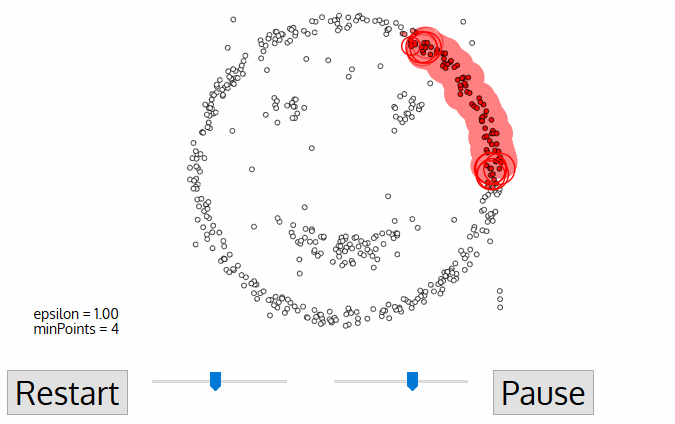

<div style="border-radius:15px;border:#B71C1B solid;background-color:#F2ECC6; padding:20px; font-size:15px">

✍️Determining the **optimum range** for **eps_range** and **min_samples_range** depends on the specific problem you are trying to solve with the clustering algorithm. However, here are some general guidelines:<blockquote>

- **eps_range:** This parameter determines the maximum distance between two points to be considered in the same neighborhood. A larger eps will result in more points being clustered together, but it can also lead to more noise being included in the clusters. A smaller eps will result in smaller and more tightly clustered groups.
In order to determine the optimum range for eps, you could try running the clustering algorithm with a range of eps values and see how well the resulting clusters align with your desired grouping.
---
- **min_samples_range:** This parameter determines the minimum number of points required to form a cluster. A larger min_samples will result in fewer and larger clusters, while a smaller min_samples will result in more and smaller clusters.
To determine the optimum range for min_samples, you could try running the clustering algorithm with a range of values and compare the resulting clusters to your desired grouping.

It's worth noting that these parameters interact with each other, so you may need to experiment with different combinations of eps and min_samples to find the best results for your specific problem. Additionally, you may want to consider other parameters in your clustering algorithm, such as the distance metric used or the clustering method, as these can also affect the clustering results.

<a id="1"></a>  
#### <p style="padding:10px;background-color:#F2ECC6;margin:0;color:#A6AD3C;font-family:newtimeroman;font-size:150%;text-align:center;border-radius: 5px 5px;overflow:hidden;font-weight:200">5.6.1. DBSCAN (Low Range of Hyperparameters)</p>

<div style="border-radius:15px;border:#B71C1B solid;background-color:#F2ECC6; padding:20px; font-size:15px">

**✍️We start with:**

- 👉 A small range of values (e.g., **eps_range** = np.arange(0.1, 1.5, 0.1)) and gradually increase the range until we find the value that produces the best results.
---
- 👉 A small range of values (e.g., **min_samples_range** = np.arange(2, 10, 1)) and gradually increase the range until we find the value that produces the best results.

In [149]:
# Define range of eps and min_samples values to be investigated
eps_range = np.arange(0.1, 1.5, 0.1)
min_samples_range = np.arange(2, 10, 1)

# Find all possible combinations of eps and min_samples values
params_grid = pd.DataFrame(list(product(eps_range, min_samples_range)), columns=['eps', 'min_samples'])
params_grid.T

,0,1,2,3,4,5,6,7,8,9,...,102,103,104,105,106,107,108,109,110,111
eps,0.1,0.1,0.1,0.1,0.1,0.1,0.1,0.1,0.2,0.2,...,1.3,1.3,1.4,1.4,1.4,1.4,1.4,1.4,1.4,1.4
min_samples,2.0,3.0,4.0,5.0,6.0,7.0,8.0,9.0,2.0,3.0,...,8.0,9.0,2.0,3.0,4.0,5.0,6.0,7.0,8.0,9.0


#### 🌴Implementation of Silhouette and Calinski-Harabasz Coefficient Metrics and Finding the Best Parameters

In [150]:
silhouette_coef = []
calinski_harabasz_coef = []
for _, row in params_grid.iterrows():
    dbscan = DBSCAN(eps=row['eps'], min_samples=row['min_samples'])
    labels = dbscan.fit_predict(scaled_col)
    score_silhouette = silhouette_score(scaled_col, labels)
    silhouette_coef.append(score_silhouette)

    dbscan.fit(scaled_col)
    score_calinski_harabasz = calinski_harabasz_score(scaled_col, dbscan.labels_)
    calinski_harabasz_coef.append(score_calinski_harabasz) 

In [151]:
# Create a dataframe to store the scores
scores_DBSCAN = pd.DataFrame({'eps': params_grid['eps'],
                              'min_samples': params_grid['min_samples'],
                              'Silhouette Score': silhouette_coef,
                              'Calinski-Harabasz Score': calinski_harabasz_coef})

# Find the best eps and min_samples for each score
best_params_silhouette = scores_DBSCAN.loc[scores_DBSCAN['Silhouette Score'].idxmax(), ['eps', 'min_samples']]
best_params_calinski_harabaz = scores_DBSCAN.loc[scores_DBSCAN['Calinski-Harabasz Score'].idxmax(), ['eps', 'min_samples']]

In [152]:
print("\nScores for Different Hyperparameters:")
scores_DBSCAN.style.background_gradient(cmap=cmap).set_properties(**{'font-family': 'Segoe UI'}).hide_index()


Scores for Different Hyperparameters:


eps,min_samples,Silhouette Score,Calinski-Harabasz Score
0.100000,2,-0.512218,1.855335
0.100000,3,-0.476031,2.723228
0.100000,4,-0.427175,3.339120
0.100000,5,-0.374889,4.108909
0.100000,6,-0.255633,9.036010
0.100000,7,-0.256013,8.701326
0.100000,8,-0.253271,11.390622
0.100000,9,-0.253609,10.590882
0.200000,2,-0.507743,2.363581
0.200000,3,-0.472741,4.430572


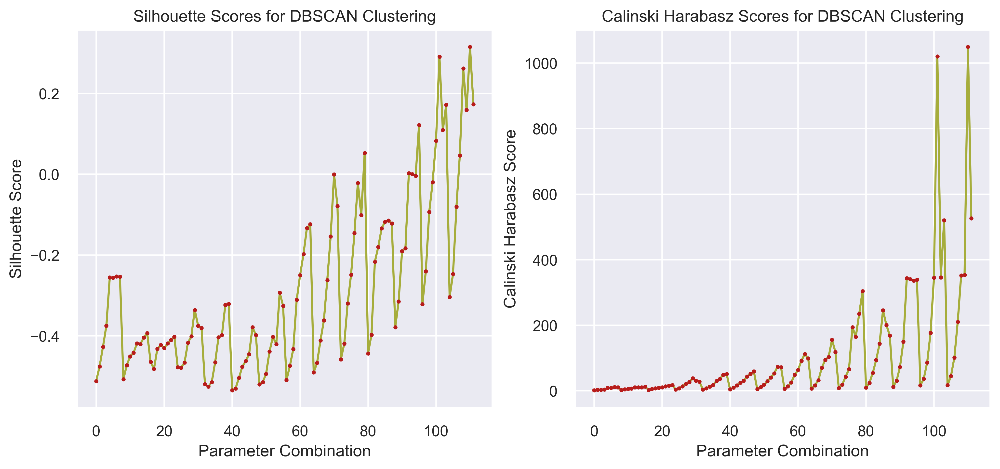

In [153]:
# Visualize plots of silhouette and calinski harabasz scores
fig, (ax1, ax2) = plt.subplots(nrows=1, ncols=2, figsize=(12, 5))

# Plot silhouette scores
ax1.plot(params_grid.index, silhouette_coef, color="#A6AD3C", marker='o', ms=3, mfc=colors[0])
ax1.set_title('Silhouette Scores for DBSCAN Clustering')
ax1.set_xlabel('Parameter Combination')
ax1.set_ylabel('Silhouette Score')

# Plot calinski harabasz scores
ax2.plot(params_grid.index, calinski_harabasz_coef, color="#A6AD3C", marker='o', ms=3, mfc=colors[0])
ax2.set_title('Calinski Harabasz Scores for DBSCAN Clustering')
ax2.set_xlabel('Parameter Combination')
ax2.set_ylabel('Calinski Harabasz Score')

plt.show()

In [154]:
# Best parameters for each score
print(f"\n▪️Best Parameters for Silhouette Score: eps = {best_params_silhouette['eps']}, min_samples = {best_params_silhouette['min_samples']}")
print(f"▪️Best Parameters for Calinski-Harabasz Score: eps = {best_params_calinski_harabaz['eps']}, min_samples = {best_params_calinski_harabaz['min_samples']}")


▪️Best Parameters for Silhouette Score: eps = 1.4000000000000001, min_samples = 8.0
▪️Best Parameters for Calinski-Harabasz Score: eps = 1.4000000000000001, min_samples = 8.0


#### 🌴Implement the DBSCAN Model

In [155]:
# Implement DBSCAN for best eps and min_sample
dbscan = DBSCAN(eps=1.4, min_samples=8)
dbscan.fit(scaled_col)

# Store result of DBSCAN
pred = dbscan.labels_

# Number of clusters in labels, ignoring noise if present
n_clusters_ = len(set(pred)) - (1 if -1 in pred else 0)
n_noise_ = list(pred).count(-1)

In [156]:
print("Estimated number of clusters: %d" % n_clusters_)
print("Estimated number of noise points: %d" % n_noise_)
print('------------------------------------')
print(f"Number of cluster: {np.unique(pred)}")

Estimated number of clusters: 1
Estimated number of noise points: 1745
------------------------------------
Number of cluster: [-1  0]


#### 🌴Evaluation of the performance of the DBSCAN model

In [157]:
# Calculate scores
silhouette = silhouette_score(scaled_col, pred)
calinski = calinski_harabasz_score(scaled_col, pred)

# Create a DataFrame with the scores
DBSCAN_scores = pd.DataFrame({'Silhouette Score': [silhouette], 'Calinski-Harabasz Score': [calinski]}, index=['DBSCAN (Low Range of Hyperparameters)'])
DBSCAN_scores

,Silhouette Score,Calinski-Harabasz Score
DBSCAN (Low Range of Hyperparameters),0.31573,1049.99649


#### 🌴Addition of Cluster Column to the Data frame

In [158]:
dbscan_clustered_df = pd.concat([df, pd.DataFrame(pred, columns=['DBSCAN Cluster'])], axis = 1)
dbscan_clustered_df.head(10).style.set_properties(**{'background-color': '#F2ECC6'}, subset=['DBSCAN Cluster'])

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,DBSCAN Cluster
0,40.900749,0.818182,95.400000,0.000000,95.400000,0.000000,0.166667,0.000000,0.083333,0.000000,0,2,1000.000000,201.802084,139.509787,0.000000,12,0
1,3202.467416,0.909091,0.000000,0.000000,0.000000,6442.945483,0.000000,0.000000,0.000000,0.250000,4,0,7000.000000,4103.032597,1072.340217,0.222222,12,0
2,2495.148862,1.000000,773.170000,773.170000,0.000000,0.000000,1.000000,1.000000,0.000000,0.000000,0,12,7500.000000,622.066742,627.284787,0.000000,12,0
3,1666.670542,0.636364,1499.000000,1499.000000,0.000000,205.788017,0.083333,0.083333,0.000000,0.083333,1,1,7500.000000,0.000000,312.452292,0.000000,12,0
4,817.714335,1.000000,16.000000,16.000000,0.000000,0.000000,0.083333,0.083333,0.000000,0.000000,0,1,1200.000000,678.334763,244.791237,0.000000,12,0
5,1809.828751,1.000000,1333.280000,0.000000,1333.280000,0.000000,0.666667,0.000000,0.583333,0.000000,0,8,1800.000000,1400.057770,2407.246035,0.000000,12,0
6,627.260806,1.000000,7091.010000,6402.630000,688.380000,0.000000,1.000000,1.000000,1.000000,0.000000,0,64,13500.000000,6354.314328,198.065894,1.000000,12,-1
7,1823.652743,1.000000,436.200000,0.000000,436.200000,0.000000,1.000000,0.000000,1.000000,0.000000,0,12,2300.000000,679.065082,532.033990,0.000000,12,0
8,1014.926473,1.000000,861.490000,661.490000,200.000000,0.000000,0.333333,0.083333,0.250000,0.000000,0,5,7000.000000,688.278568,311.963409,0.000000,12,0
9,152.225975,0.545455,1281.600000,1281.600000,0.000000,0.000000,0.166667,0.166667,0.000000,0.000000,0,3,11000.000000,1164.770591,100.302262,0.000000,12,0


In [159]:
dbscan_clustered_df.shape

(8949, 18)

#### 🌴Size of the Clusters

In [160]:
DBSCAN_clust_sizes = dbscan_clustered_df.groupby('DBSCAN Cluster').size().to_frame()
DBSCAN_clust_sizes.columns = ["DBSCAN Size (Low Range)"]
DBSCAN_clust_sizes

,DBSCAN Size (Low Range)
DBSCAN Cluster,
-1,1745
0,7204


#### 🌴Distribution of Data Points by Cluster

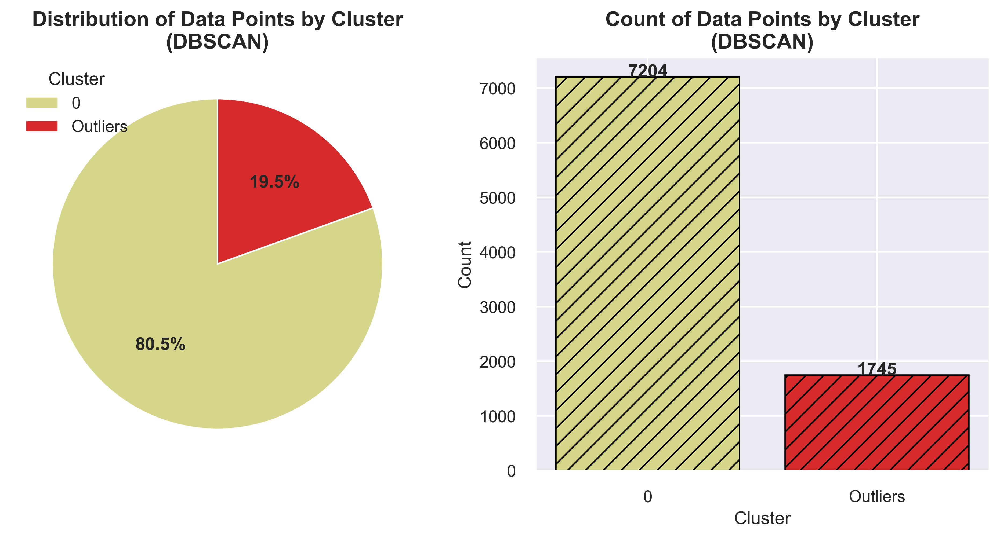

In [161]:
# Create data for the pie chart
counts = dbscan_clustered_df['DBSCAN Cluster'].value_counts()
counts.index = counts.index.astype(str)
counts['Outliers'] = counts.pop('-1')
labels = counts.index.tolist()
sizes = counts.tolist()

# Define the color palette
colors = ["#D5D68A", "#D72A2B"]

# Create the figure and axis objects
fig, (ax1, ax2) = plt.subplots(nrows=1, ncols=2, figsize=(12,5))

# Create the pie chart
pie_chart = ax1.pie(sizes, colors=colors, autopct='%1.1f%%', startangle=90, textprops={'fontsize': 12, 'fontweight': 'bold'})

# Add legend to the pie chart
ax1.legend(pie_chart[0], labels, loc="best", title='Cluster')

# Add title to the pie chart
ax1.set_title("Distribution of Data Points by Cluster\n(DBSCAN)", fontsize=14, fontweight='bold')

# Create the bar plot
bar_plot = ax2.bar(labels, sizes, color=colors, edgecolor='black', linewidth=1, hatch='//')

# Add title to the bar plot
ax2.set_xlabel('Cluster', fontsize= 12)
ax2.set_ylabel('Count', fontsize= 12)
ax2.set_title("Count of Data Points by Cluster\n(DBSCAN)", fontsize=14, fontweight='bold')

# Add labels to the bar plot
for i, v in enumerate(sizes):
    ax2.text(i, v+10, str(v), ha='center', fontsize=12, fontweight='bold')

# Show the plot
plt.show()

#### 🌴Cluster Analysis and customers segmentation

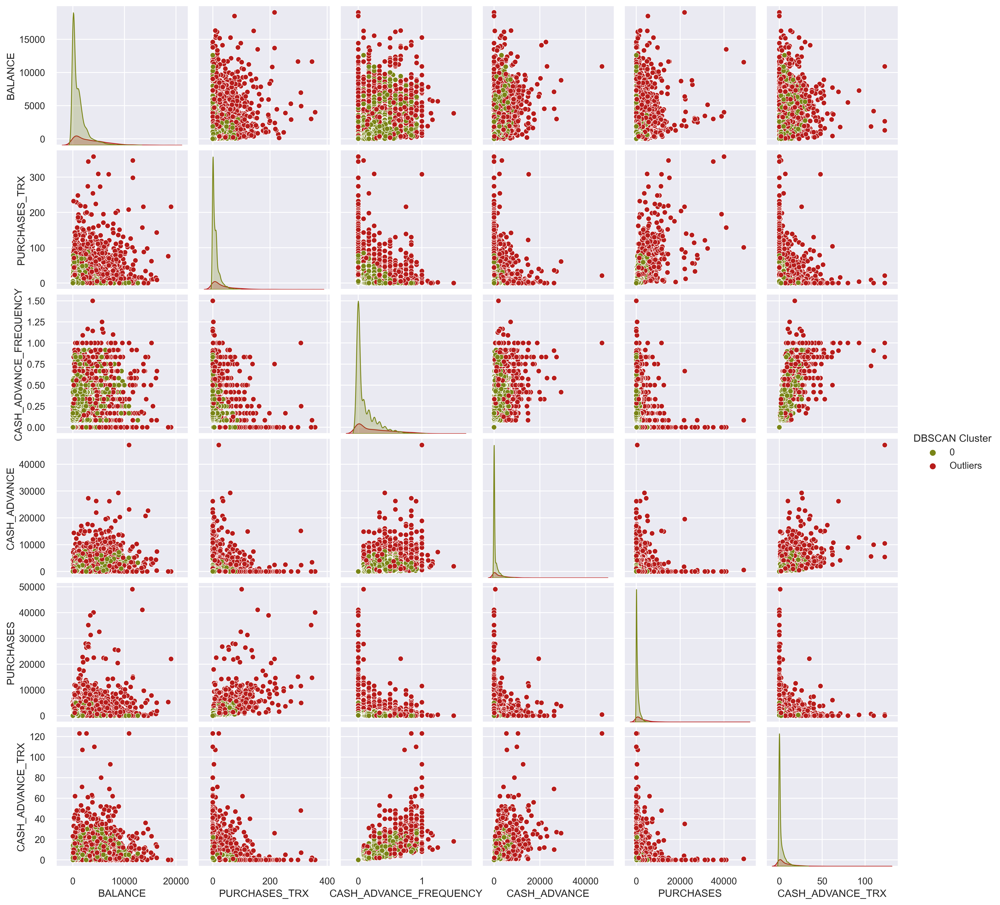

In [163]:
colors = ["#798517", "#B71C1B"]
important_variables = ['BALANCE', 'PURCHASES_TRX', 'CASH_ADVANCE_FREQUENCY', 'CASH_ADVANCE', 'PURCHASES', 'CASH_ADVANCE_TRX', 'DBSCAN Cluster']

dbscan_clustered_df['DBSCAN Cluster'] = dbscan_clustered_df['DBSCAN Cluster'].replace(-1, 'Outliers')

sns.set_palette(colors)
sns.pairplot(dbscan_clustered_df[important_variables], hue='DBSCAN Cluster')
plt.show()

In [164]:
# Plot of clusters
fig = px.scatter(dbscan_clustered_df, x="PURCHASES", y="CASH_ADVANCE_TRX", color="DBSCAN Cluster", 
                 color_discrete_sequence=px.colors.qualitative.Prism)
fig.update_traces(marker=dict(size=11, opacity=0.75, line=dict(width=1, color='#F7F7F7')))
fig.update_layout(template=temp, title="DBSCAN Cluster Profiles,<br>PURCHASES vs. CASH_ADVANCE_TRX", 
                  width=700, legend_title='DBSCAN Cluster',
                  xaxis=dict(title='PURCHASES', showline=True, zeroline=False), 
                  yaxis=dict(title='CASH_ADVANCE_TRX', ticksuffix='k', showline=True))
fig.show()

In [165]:
# Summarizing the average values of each feature within each cluster
avg_df = dbscan_clustered_df.groupby(['DBSCAN Cluster'], as_index=False).mean()
avg_df.style.background_gradient(cmap=cmap).set_properties(**{'font-family': 'Segoe UI'}).hide_index()

DBSCAN Cluster,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
0,1139.787013,0.867516,572.383118,304.301115,268.361796,577.691644,0.451681,0.157953,0.335759,0.105124,2.132426,9.831205,3661.753228,1027.048899,535.308917,0.147225,11.579539
Outliers,3318.627888,0.917950,2782.369788,1782.309020,1000.445295,2635.540974,0.650272,0.386306,0.483041,0.259059,7.859026,34.859026,7932.124859,4649.150813,2123.535596,0.180596,11.263610


In [166]:
db_g = pd.DataFrame(dbscan_clustered_df.groupby(['DBSCAN Cluster','TENURE'])['TENURE'].count())
db_g.T.style.background_gradient(cmap=cmap).set_properties(**{'font-family': 'Segoe UI'})

#### 🌴Distribution of the most important features after Clustering

In [167]:
features = ['BALANCE', 'PURCHASES_TRX', 'CASH_ADVANCE_FREQUENCY', 'CASH_ADVANCE', 'PURCHASES', 'CASH_ADVANCE_TRX']

for feature in features:
    fig = px.histogram(dbscan_clustered_df, x=feature, color='DBSCAN Cluster', template=temp,
                       marginal='box', opacity=0.7, nbins=50, color_discrete_sequence=[custom_colors[2], custom_colors[0]],
                       barmode='group', histfunc='count')
    
    fig.update_layout(
        font_family='monospace',
        title=dict(text=f'Distribution of {feature} After Clustering', x=0.5, y=0.95,
                   font=dict(color=custom_colors[2], size=20)),
        xaxis_title_text=feature,
        yaxis_title_text='Count',
        legend=dict(x=1, y=0.96, bordercolor=custom_colors[1], borderwidth=0, tracegroupgap=5),
        bargap=0.3,
    )
    fig.show()

<a id="1"></a>  
#### <p style="padding:10px;background-color:#F2ECC6;margin:0;color:#A6AD3C;font-family:newtimeroman;font-size:150%;text-align:center;border-radius: 5px 5px;overflow:hidden;font-weight:200">5.6.2. DBSCAN (High Range of Hyperparameters)</p>

<div style="border-radius:15px;border:#B71C1B solid;background-color:#F2ECC6; padding:20px; font-size:15px">

✍️Let's **increase** the range of **eps_range** and **min_samples_range** to find the best results.

In [168]:
# Define range of eps and min_samples values to be investigated
eps_range = np.arange(1, 15, 2)
min_samples_range = np.arange(20, 41, 10)

# Find all possible combinations of eps and min_samples values
params_grid = pd.DataFrame(list(product(eps_range, min_samples_range)), columns=['eps', 'min_samples'])
params_grid.T

,0,1,2,3,4,5,6,7,8,9,...,11,12,13,14,15,16,17,18,19,20
eps,1,1,1,3,3,3,5,5,5,7,...,7,9,9,9,11,11,11,13,13,13
min_samples,20,30,40,20,30,40,20,30,40,20,...,40,20,30,40,20,30,40,20,30,40


#### 🌴Implementation of Silhouette and Calinski-Harabasz Coefficient Metrics and Finding the Best Parameters

In [169]:
silhouette_coef = []
calinski_harabasz_coef = []
for _, row in params_grid.iterrows():
    dbscan = DBSCAN(eps=row['eps'], min_samples=row['min_samples'])
    labels = dbscan.fit_predict(scaled_col)
    score_silhouette = silhouette_score(scaled_col, labels)
    silhouette_coef.append(score_silhouette)

    dbscan.fit(scaled_col)
    score_calinski_harabasz = calinski_harabasz_score(scaled_col, dbscan.labels_)
    calinski_harabasz_coef.append(score_calinski_harabasz) 

In [170]:
# Create a dataframe to store the scores
scores_DBSCAN = pd.DataFrame({'eps': params_grid['eps'],
                              'min_samples': params_grid['min_samples'],
                              'Silhouette Score': silhouette_coef,
                              'Calinski-Harabasz Score': calinski_harabasz_coef})

# Find the best eps and min_samples for each score
best_params_silhouette = scores_DBSCAN.loc[scores_DBSCAN['Silhouette Score'].idxmax(), ['eps', 'min_samples']]
best_params_calinski_harabaz = scores_DBSCAN.loc[scores_DBSCAN['Calinski-Harabasz Score'].idxmax(), ['eps', 'min_samples']]

In [171]:
print("\nScores for Different Hyperparameters:")
scores_DBSCAN.style.background_gradient(cmap=cmap).set_properties(**{'font-family': 'Segoe UI'}).hide_index()


Scores for Different Hyperparameters:


eps,min_samples,Silhouette Score,Calinski-Harabasz Score
1,20,0.075034,405.235382
1,30,0.053177,405.031877
1,40,0.044634,386.399249
3,20,0.599402,940.079302
3,30,0.591029,946.535487
3,40,0.583559,954.363857
5,20,0.745439,688.837792
5,30,0.736273,704.010253
5,40,0.732415,725.559717
7,20,0.789433,642.887862


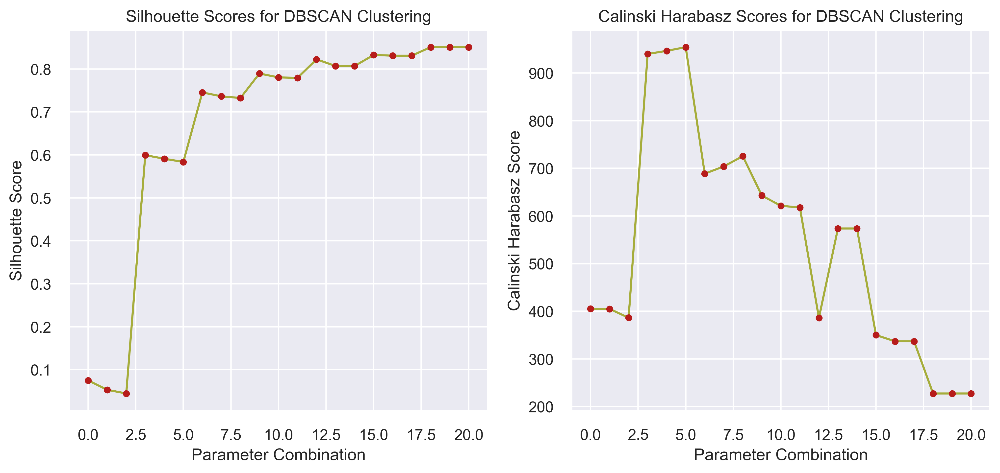

In [172]:
# Visualize plots of silhouette and calinski harabasz scores for
fig, (ax1, ax2) = plt.subplots(nrows=1, ncols=2, figsize=(12, 5))

# Plot silhouette scores
ax1.plot(params_grid.index, silhouette_coef, color="#A6AD3C", marker='o', ms=5, mfc=colors[-1])
ax1.set_title('Silhouette Scores for DBSCAN Clustering')
ax1.set_xlabel('Parameter Combination')
ax1.set_ylabel('Silhouette Score')

# Plot calinski harabasz scores
ax2.plot(params_grid.index, calinski_harabasz_coef, color="#A6AD3C", marker='o', ms=5, mfc=colors[-1])
ax2.set_title('Calinski Harabasz Scores for DBSCAN Clustering')
ax2.set_xlabel('Parameter Combination')
ax2.set_ylabel('Calinski Harabasz Score')

plt.show()

In [173]:
# Best parameters for each score
print(f"\n▪️Best Parameters for Silhouette Score: eps = {best_params_silhouette['eps']}, min_samples = {best_params_silhouette['min_samples']}")
print(f"▪️Best Parameters for Calinski-Harabasz Score: eps = {best_params_calinski_harabaz['eps']}, min_samples = {best_params_calinski_harabaz['min_samples']}")


▪️Best Parameters for Silhouette Score: eps = 13.0, min_samples = 20.0
▪️Best Parameters for Calinski-Harabasz Score: eps = 3.0, min_samples = 40.0


<div style="border-radius:15px;border:#B71C1B solid;background-color:#F2ECC6; padding:20px; font-size:15px">

✍️Based on the optained information, the best parameters for the Silhouette Score are (eps=13 and min_samples=20), while the best parameters for the Calinski-Harabasz Score are (eps=3 and min_samples=40). These two sets of parameters result in different clustering performance metrics, so the choice of which parameters to use would depend on the specific goals of the analysis and the characteristics of the dataset.

<blockquote>
    
- 1️⃣If the goal is to obtain **well-defined clusters** with a high Silhouette Score, then the parameters (eps=13 and min_samples=20) may be the better choice. 
---    
- 2️⃣However, if the goal is to obtain clusters with a **high between-cluster variance** compared to **within-cluster variance**, then the parameters (eps=3 and min_samples=40) may be more appropriate.

✅**So**, I decided to try out different parameter combinations using **multiple metrics** (including both the Silhouette Score and Calinski-Harabasz Score) to determine the **optimal parameters**.

#### 🌴Evaluate the performance using Multiple metrics

In [174]:
# Define the range of parameter values to search
eps_range = np.arange(1, 15, 2)
min_samples_range = np.arange(20, 41, 10)

# Initialize variables to store the best parameters and scores
best_eps = None
best_min_samples = None
best_silhouette_score = -1
best_calinski_harabasz_score = -1

# Loop through all parameter combinations
for eps in eps_range:
    for min_samples in min_samples_range:
        # Perform DBSCAN clustering with current parameter combination
        dbscan = DBSCAN(eps=eps, min_samples=min_samples)
        labels = dbscan.fit_predict(scaled_col)

        # Compute the Silhouette Score and Calinski-Harabasz Score
        silhouette = silhouette_score(scaled_col, labels)
        calinski_harabasz = calinski_harabasz_score(scaled_col, labels)

        # Update the best parameters and scores if the current combination is better
        if silhouette > best_silhouette_score:
            best_silhouette_score = silhouette
            best_calinski_harabasz_score = calinski_harabasz
            best_eps = eps
            best_min_samples = min_samples

In [175]:
# Print the best parameters and scores
print("\n👍Best Parameters for Silhouette Score: eps =", best_eps, "min_samples =", best_min_samples)
print("-------------------------------------------------------------------------")
print("👍Best Parameters for Calinski-Harabasz Score: eps =", best_eps, "min_samples =", best_min_samples)


👍Best Parameters for Silhouette Score: eps = 13 min_samples = 20
-------------------------------------------------------------------------
👍Best Parameters for Calinski-Harabasz Score: eps = 13 min_samples = 20


<div style="border-radius:15px;border:#B71C1B solid;background-color:#F2ECC6; padding:20px; font-size:15px">

✍️This hyperparameter set **(eps = 13 | min_samples = 20)** leads to a **well-defined clustering**.

#### 🌴Implement the DBSCAN Model

In [176]:
# Implement DBSCAN for best eps and min_sample
dbscan = DBSCAN(eps=13, min_samples=20)
dbscan.fit(scaled_col)

# Store result of DBSCAN
pred = dbscan.labels_

# Number of clusters in labels, ignoring noise if present
n_clusters_ = len(set(pred)) - (1 if -1 in pred else 0)
n_noise_ = list(pred).count(-1)

In [177]:
print("Estimated number of clusters: %d" % n_clusters_)
print("Estimated number of noise points: %d" % n_noise_)
print('------------------------------------')
print(f"Number of cluster: {np.unique(pred)}")

Estimated number of clusters: 1
Estimated number of noise points: 6
------------------------------------
Number of cluster: [-1  0]


#### 🌴Evaluation of the performance of the DBSCAN model

In [178]:
# Calculate scores
silhouette = silhouette_score(scaled_col, pred)
calinski = calinski_harabasz_score(scaled_col, pred)

# Create a DataFrame with the scores
DBSCAN1_scores = pd.DataFrame({'Silhouette Score': [silhouette], 'Calinski-Harabasz Score': [calinski]}, index=['DBSCAN (High Range of Hyperparameters)'])
DBSCAN1_scores

,Silhouette Score,Calinski-Harabasz Score
DBSCAN (High Range of Hyperparameters),0.850801,227.470641


#### 🌴Addition of Cluster Column to the Data frame

In [179]:
dbscan1_clustered_df = pd.concat([df, pd.DataFrame(pred, columns=['DBSCAN Cluster'])], axis = 1)
dbscan1_clustered_df.head(10).style.set_properties(**{'background-color': '#F2ECC6'}, subset=['DBSCAN Cluster'])

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,DBSCAN Cluster
0,40.900749,0.818182,95.400000,0.000000,95.400000,0.000000,0.166667,0.000000,0.083333,0.000000,0,2,1000.000000,201.802084,139.509787,0.000000,12,0
1,3202.467416,0.909091,0.000000,0.000000,0.000000,6442.945483,0.000000,0.000000,0.000000,0.250000,4,0,7000.000000,4103.032597,1072.340217,0.222222,12,0
2,2495.148862,1.000000,773.170000,773.170000,0.000000,0.000000,1.000000,1.000000,0.000000,0.000000,0,12,7500.000000,622.066742,627.284787,0.000000,12,0
3,1666.670542,0.636364,1499.000000,1499.000000,0.000000,205.788017,0.083333,0.083333,0.000000,0.083333,1,1,7500.000000,0.000000,312.452292,0.000000,12,0
4,817.714335,1.000000,16.000000,16.000000,0.000000,0.000000,0.083333,0.083333,0.000000,0.000000,0,1,1200.000000,678.334763,244.791237,0.000000,12,0
5,1809.828751,1.000000,1333.280000,0.000000,1333.280000,0.000000,0.666667,0.000000,0.583333,0.000000,0,8,1800.000000,1400.057770,2407.246035,0.000000,12,0
6,627.260806,1.000000,7091.010000,6402.630000,688.380000,0.000000,1.000000,1.000000,1.000000,0.000000,0,64,13500.000000,6354.314328,198.065894,1.000000,12,0
7,1823.652743,1.000000,436.200000,0.000000,436.200000,0.000000,1.000000,0.000000,1.000000,0.000000,0,12,2300.000000,679.065082,532.033990,0.000000,12,0
8,1014.926473,1.000000,861.490000,661.490000,200.000000,0.000000,0.333333,0.083333,0.250000,0.000000,0,5,7000.000000,688.278568,311.963409,0.000000,12,0
9,152.225975,0.545455,1281.600000,1281.600000,0.000000,0.000000,0.166667,0.166667,0.000000,0.000000,0,3,11000.000000,1164.770591,100.302262,0.000000,12,0


In [180]:
dbscan1_clustered_df.shape

(8949, 18)

#### 🌴Size of the Clusters

In [181]:
DBSCAN1_clust_sizes = dbscan1_clustered_df.groupby('DBSCAN Cluster').size().to_frame()
DBSCAN1_clust_sizes.columns = ["DBSCAN Size (High Range)"]
DBSCAN1_clust_sizes

,DBSCAN Size (High Range)
DBSCAN Cluster,
-1,6
0,8943


#### 🌴Distribution of Data Points by Cluster

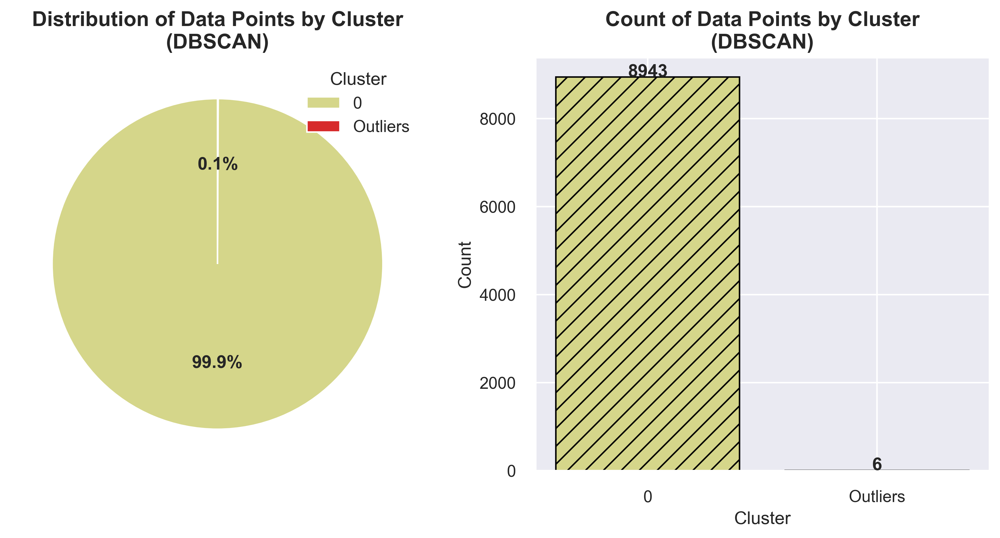

In [182]:
# Create data for the pie chart
counts = dbscan1_clustered_df['DBSCAN Cluster'].value_counts()
counts.index = counts.index.astype(str)
counts['Outliers'] = counts.pop('-1')
labels = counts.index.tolist()
sizes = counts.tolist()

# Define the color palette
colors = ["#D5D68A", "#D72A2B"]

# Create the figure and axis objects
fig, (ax1, ax2) = plt.subplots(nrows=1, ncols=2, figsize=(12,5))

# Create the pie chart
pie_chart = ax1.pie(sizes, colors=colors, autopct='%1.1f%%', startangle=90, textprops={'fontsize': 12, 'fontweight': 'bold'})

# Add legend to the pie chart
ax1.legend(pie_chart[0], labels, loc="best", title='Cluster')

# Add title to the pie chart
ax1.set_title("Distribution of Data Points by Cluster\n(DBSCAN)", fontsize=14, fontweight='bold')

# Create the bar plot
bar_plot = ax2.bar(labels, sizes, color=colors, edgecolor='black', linewidth=1, hatch='//')

# Add title to the bar plot
ax2.set_xlabel('Cluster', fontsize= 12)
ax2.set_ylabel('Count', fontsize= 12)
ax2.set_title("Count of Data Points by Cluster\n(DBSCAN)", fontsize=14, fontweight='bold')

# Add labels to the bar plot
for i, v in enumerate(sizes):
    ax2.text(i, v+10, str(v), ha='center', fontsize=12, fontweight='bold')

# Show the plot
plt.show()

#### 🌴Cluster Analysis and customers segmentation

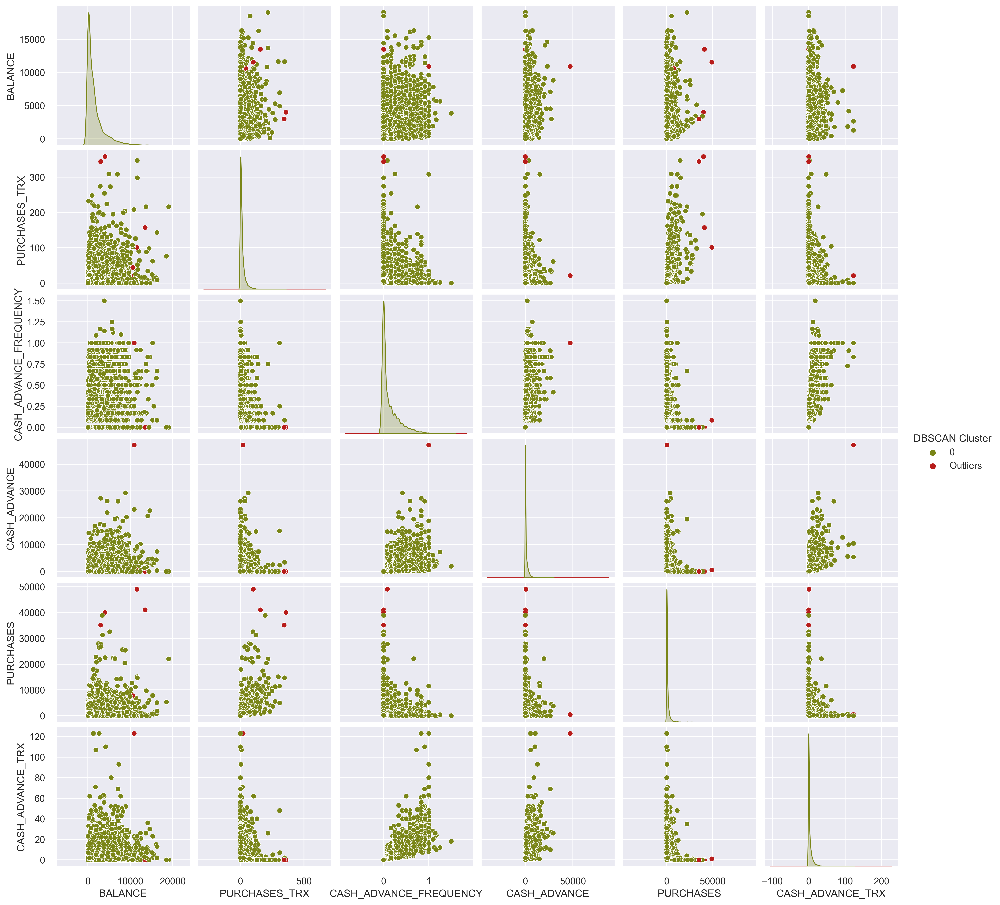

In [184]:
colors = ["#798517", "#B71C1B"]

dbscan1_clustered_df['DBSCAN Cluster'] = dbscan1_clustered_df['DBSCAN Cluster'].replace(-1, 'Outliers')

sns.set_palette(colors)
sns.pairplot(dbscan1_clustered_df[important_variables], hue='DBSCAN Cluster')
plt.show()

In [185]:
# Plot of clusters
fig = px.scatter(dbscan1_clustered_df, x="PURCHASES", y="CASH_ADVANCE_TRX", color="DBSCAN Cluster", 
                 color_discrete_sequence=px.colors.qualitative.Prism)
fig.update_traces(marker=dict(size=11, opacity=0.75, line=dict(width=1, color='#F7F7F7')))
fig.update_layout(template=temp, title="DBSCAN Cluster Profiles,<br>PURCHASES vs. CASH_ADVANCE_TRX", 
                  width=700, legend_title='DBSCAN Cluster',
                  xaxis=dict(title='PURCHASES', showline=True, zeroline=False), 
                  yaxis=dict(title='CASH_ADVANCE_TRX', ticksuffix='k', showline=True))
fig.show()

In [186]:
# Summarizing the average values of each feature within each cluster
avg_df = dbscan1_clustered_df.groupby(['DBSCAN Cluster'], as_index=False).mean()
avg_df.style.background_gradient(cmap=cmap).set_properties(**{'font-family': 'Segoe UI'}).hide_index()

DBSCAN Cluster,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
0,1559.713679,0.877268,984.596893,577.229611,407.667699,974.283152,0.490129,0.202178,0.364201,0.135110,3.237392,14.606732,4486.607193,1713.519250,834.146886,0.153602,11.517612
Outliers,8918.645483,1.000000,28905.541667,23358.343333,5547.198333,7949.229774,0.902778,0.652778,0.777778,0.180556,20.666667,170.833333,16183.333333,31270.964437,17026.575445,0.347222,12.000000


In [187]:
db_g = pd.DataFrame(dbscan1_clustered_df.groupby(['DBSCAN Cluster','TENURE'])['TENURE'].count())
db_g.T.style.background_gradient(cmap=cmap).set_properties(**{'font-family': 'Segoe UI'})

#### 🌴Distribution of the most important features after Clustering

In [188]:
features = ['BALANCE', 'PURCHASES_TRX', 'CASH_ADVANCE_FREQUENCY', 'CASH_ADVANCE', 'PURCHASES', 'CASH_ADVANCE_TRX']

for feature in features:
    fig = px.histogram(dbscan1_clustered_df, x=feature, color='DBSCAN Cluster', template=temp,
                       marginal='box', opacity=0.7, nbins=50, color_discrete_sequence=[custom_colors[2], custom_colors[0]],
                       barmode='group', histfunc='count')
    
    fig.update_layout(
        font_family='monospace',
        title=dict(text=f'Distribution of {feature} After Clustering', x=0.5, y=0.95,
                   font=dict(color=custom_colors[2], size=20)),
        xaxis_title_text=feature,
        yaxis_title_text='Count',
        legend=dict(x=1, y=0.96, bordercolor=custom_colors[1], borderwidth=0, tracegroupgap=5),
        bargap=0.3,
    )
    fig.show()